# Exploratory Data Analysis on Terrorism

### Importing Libraries

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px

### Collecting data

In [102]:
df= pd.read_csv('GlobalTerrorismData(GTD)(1970-2020).csv',encoding='ISO-8859-1')

/var/folders/t9/q352d67111n132g188862whw0000gn/T/ipykernel_9848/541071825.py:1: DtypeWarning:

Columns (4,31,33,54,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.



In [103]:
df.head()

,ï»¿eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [104]:
df.shape

(209706, 135)

In [105]:
df.columns

Index(['ï»¿eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [106]:
df.rename(columns={'iyear':'Year','imonth':'month','iday':'Day','country_txt':'Country','provstate':'state',
                   'region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed',
                   'nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                   'weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)

In [107]:
df=df[['Year','month','Day','Country','state','Region','city','latitude','longitude','AttackType','Killed','Wounded',
       'Target','Summary','Group','Target_type','Weapon_type','Motive']]
                        

In [108]:
df.head()

,Year,month,Day,Country,state,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive
0,1970,7,2,Dominican Republic,National,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN
1,1970,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN
3,1970,1,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,U.S. Embassy,NaN,Unknown,Government (Diplomatic),Explosives,NaN
4,1970,1,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,U.S. Consulate,NaN,Unknown,Government (Diplomatic),Incendiary,NaN


## Exploratory Data Analysis

array([[<Axes: title={'center': 'Year'}>,
        <Axes: title={'center': 'month'}>,
        <Axes: title={'center': 'Day'}>],
       [<Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'Killed'}>],
       [<Axes: title={'center': 'Wounded'}>, <Axes: >, <Axes: >]],
      dtype=object)

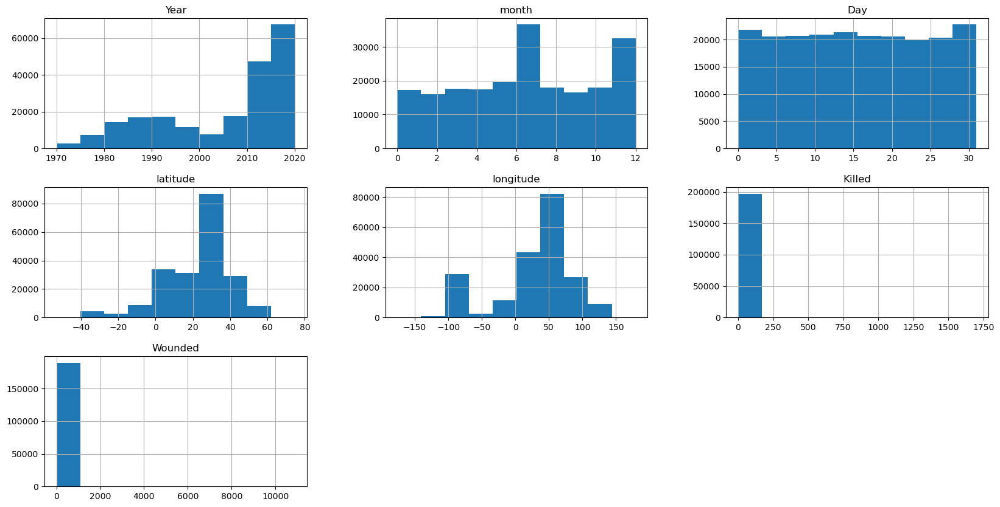

In [109]:
df.hist(figsize=(20,10))

In [110]:
df.describe()

,Year,month,Day,latitude,longitude,Killed,Wounded
count,209706.000000,209706.000000,209706.000000,205015.000000,205014.000000,197179.000000,189770.000000
mean,2004.800993,6.455285,15.527930,23.358696,30.416738,2.431030,3.085872
std,13.519321,3.387098,8.801104,18.137061,56.113029,11.340882,40.916175
min,1970.000000,0.000000,0.000000,-53.154613,-176.176447,0.000000,0.000000
25%,1992.000000,4.000000,8.000000,11.510046,8.748117,0.000000,0.000000
50%,2012.000000,6.000000,15.000000,31.300213,43.746215,0.000000,0.000000
75%,2015.000000,9.000000,23.000000,34.557022,68.835918,2.000000,2.000000
max,2020.000000,12.000000,31.000000,74.633553,179.366667,1700.000000,10878.000000


### Corelation Analysis

/var/folders/t9/q352d67111n132g188862whw0000gn/T/ipykernel_9848/141009232.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

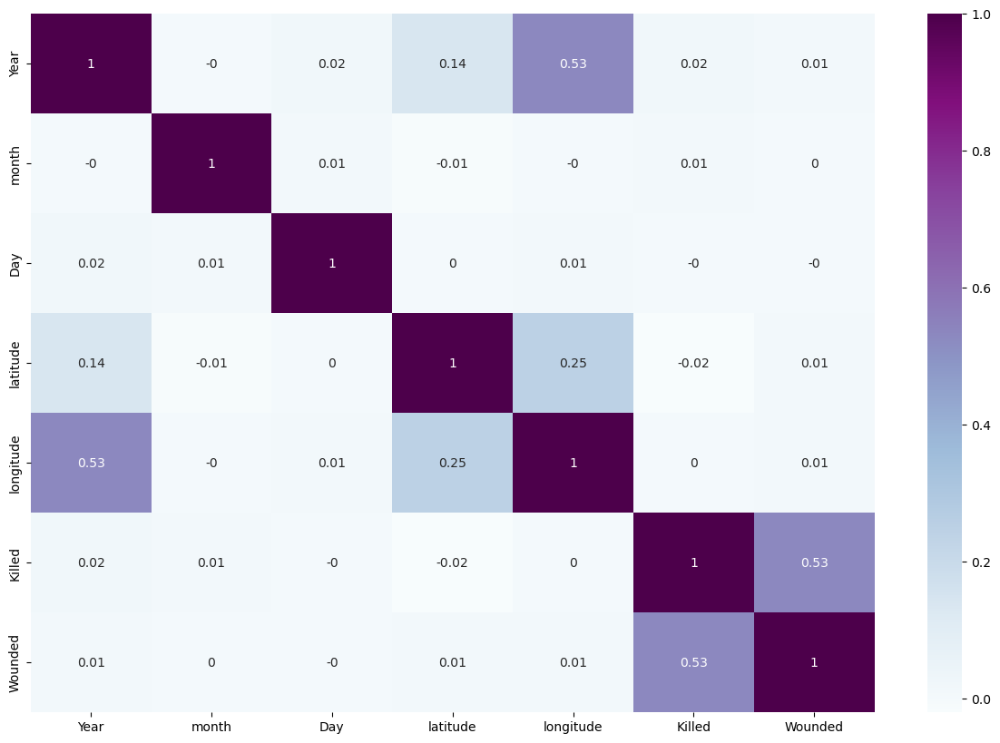

In [111]:
plt.figure(figsize=(15,10))
sns.heatmap(np.round(df.corr(),2),annot=True,cmap='BuPu')

### Terrorist Activities by Region in each Year through Area Plot

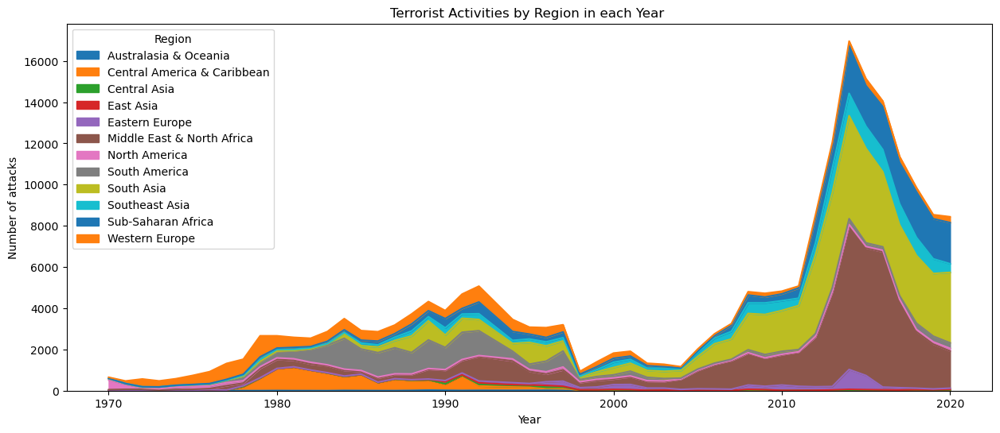

In [112]:
pd.crosstab(df.Year,df.Region).plot(kind='area',figsize=(15,6))
plt.title('Terrorist Activities by Region in each Year ')
plt.ylabel('Number of attacks')
plt.show()

### Number of Terrorist Activities each Year

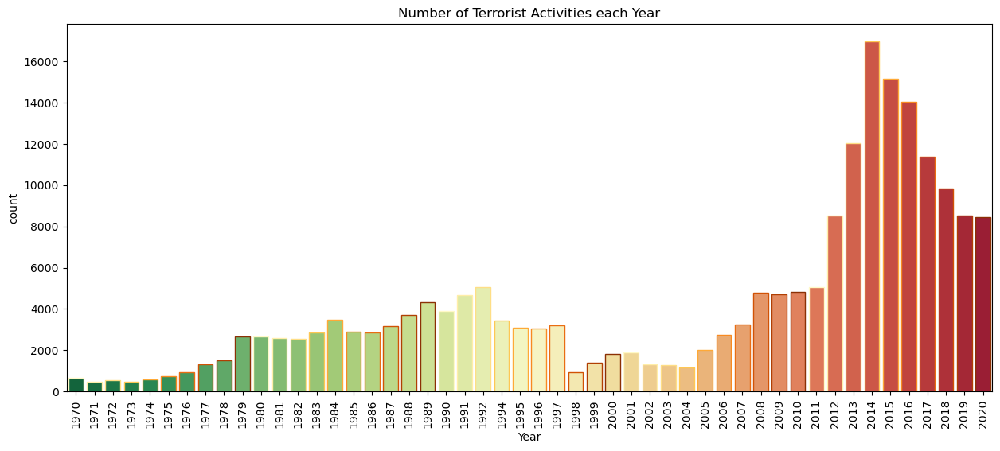

In [113]:
plt.subplots(figsize=(15,6))
sns.countplot(x='Year', data=df, palette='RdYlGn_r', edgecolor=sns.color_palette("YlOrBr", 10))
plt.xticks(rotation=90)
plt.title("Number of Terrorist Activities each Year")
plt.show()              

*Since 2014 and 2015 has a large number of Terrorist activities.*

### Number of attack were there in 1970 & 2017 and Also find percentage the attacks have increased

In [115]:
Year=df.Year.value_counts().to_dict()
rate=((Year[2020]-Year[1970])/Year[2020])*100
print(Year[1970],'attacks happened in 1970 &',Year[2020],'attacks happened in 2020')
print('The number of attacks from 1970 has increased by',np.round(rate,0),'% till 2020')

651 attacks happened in 1970 & 8438 attacks happened in 2020
The number of attacks from 1970 has increased by 92.0 % till 2020


### The number of casualities corresponding to the killed people in each country for each year.

In [117]:
fig=px.scatter(df,df.Wounded,df.Killed,hover_name='Country',animation_frame='Year',animation_group='Country',
           color='AttackType',range_color=[0,1],labels={'Killed':'Deaths','Wounded':'Casualities'},
           title='Number of casualities vs Killed people in each country for each year')
fig.show()

### Methods of attack

In [118]:
df['AttackType'] = pd.Series(df['AttackType'])


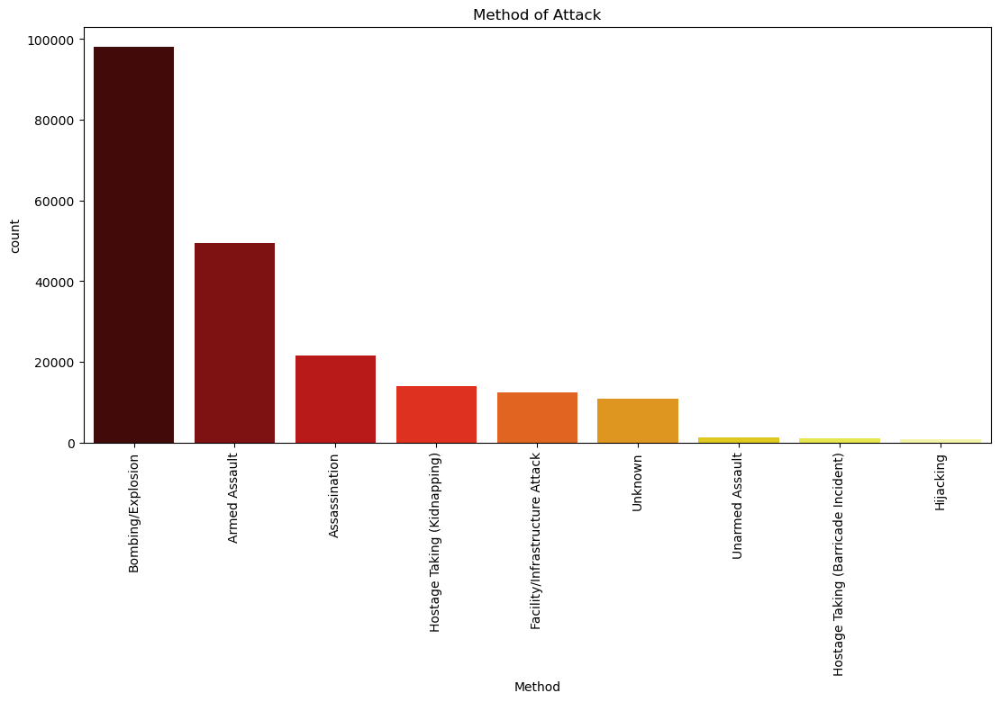

In [119]:
plt.figure(figsize=(13,6))
sns.countplot(x=df['AttackType'],order=df['AttackType'].value_counts().index,
              palette='hot')
plt.xticks(rotation=90)
plt.xlabel('Method')
plt.title('Method of Attack')
plt.show()

*From the above chart it is clear that Bombing/Explosion method was mostly used while attacking.*

### Type of target

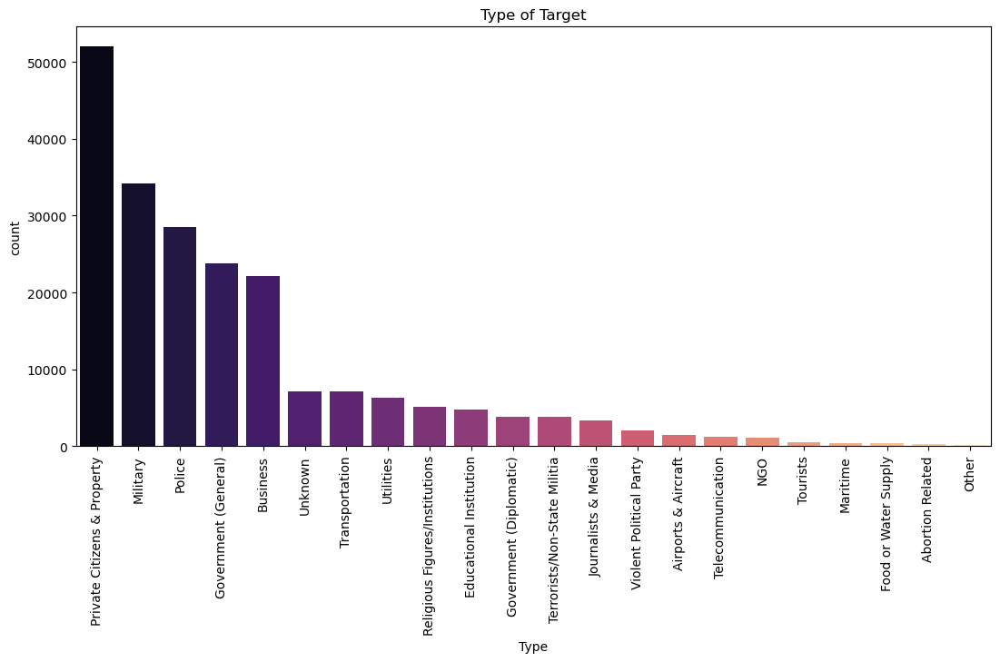

In [120]:
plt.figure(figsize=(13,6))
sns.countplot(x=df['Target_type'],order=df['Target_type'].value_counts().index,
              palette='magma')
plt.xticks(rotation=90)
plt.xlabel('Type')
plt.title('Type of Target')
plt.show()


### Total number of terrorist attack in each country and regions using barplot

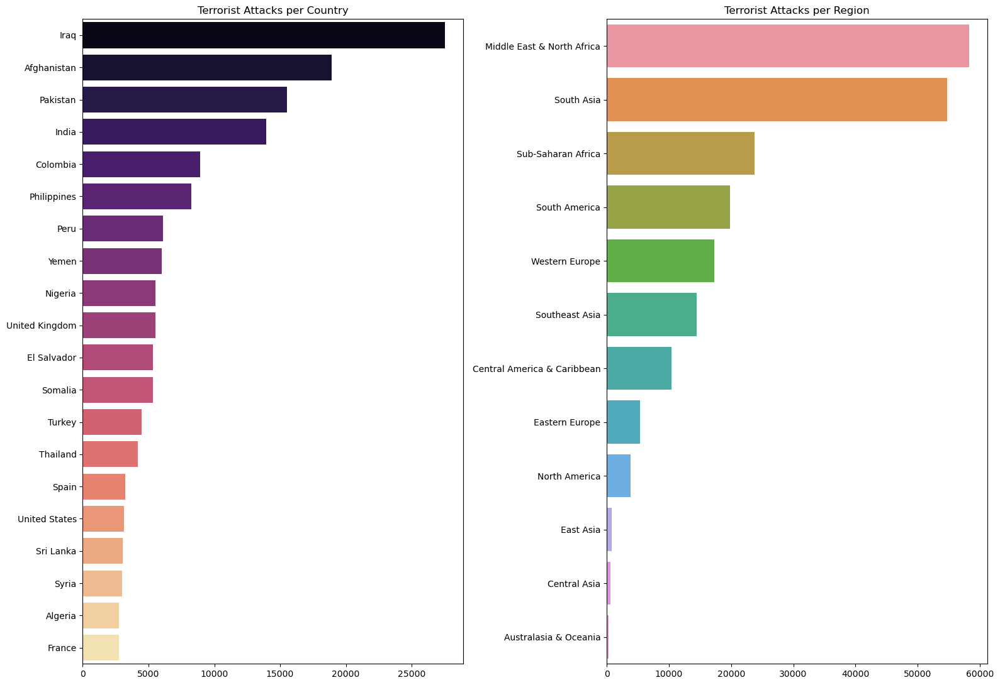

In [121]:
fig,axes = plt.subplots(figsize=(16,11),nrows=1,ncols=2)
sns.barplot(x = df['Country'].value_counts()[:20].values, y = df['Country'].value_counts()[:20].index, 
            ax=axes[0],palette = 'magma');
axes[0].set_title('Terrorist Attacks per Country')
sns.barplot(x=df['Region'].value_counts().values,y=df['Region'].value_counts().index,
            ax=axes[1])
axes[1].set_title('Terrorist Attacks per Region')
fig.tight_layout()
plt.show()

### The total number of attacks in each country using Globe

#### We will first create a new dataframe which contains the total count of attacks for each country in order to use it as a colour bar.

In [122]:
terr=df.groupby(['Country'],as_index=False).count()

In [123]:
fig=px.choropleth(terr,locations='Country',locationmode='country names',
                  color='Year',hover_name='Country',projection='orthographic',
                  title='Total number of attacks (1970-2017)',labels={'Year':'Attacks'})
fig.show()

#### Country suffered the maximum attacks(state the number) and country suffered minimum attacks(state the number)

In [124]:
min_count=terr['Year'].min()
min_id=terr['Year'].idxmin()
min_name=terr['Country'][min_id]
max_count=terr['Year'].max()
max_id=terr['Year'].idxmax()
max_name=terr['Country'][max_id]

In [125]:
print(min_name,'has suffered the minimum number of terror attacks of',min_count)
print(max_name,'has suffered the maximum number of terror attacks of',max_count)

Andorra has suffered the minimum number of terror attacks of 1
Iraq has suffered the maximum number of terror attacks of 27521


**Now let us check out which terrorist organizations have carried out their operations in each country.**

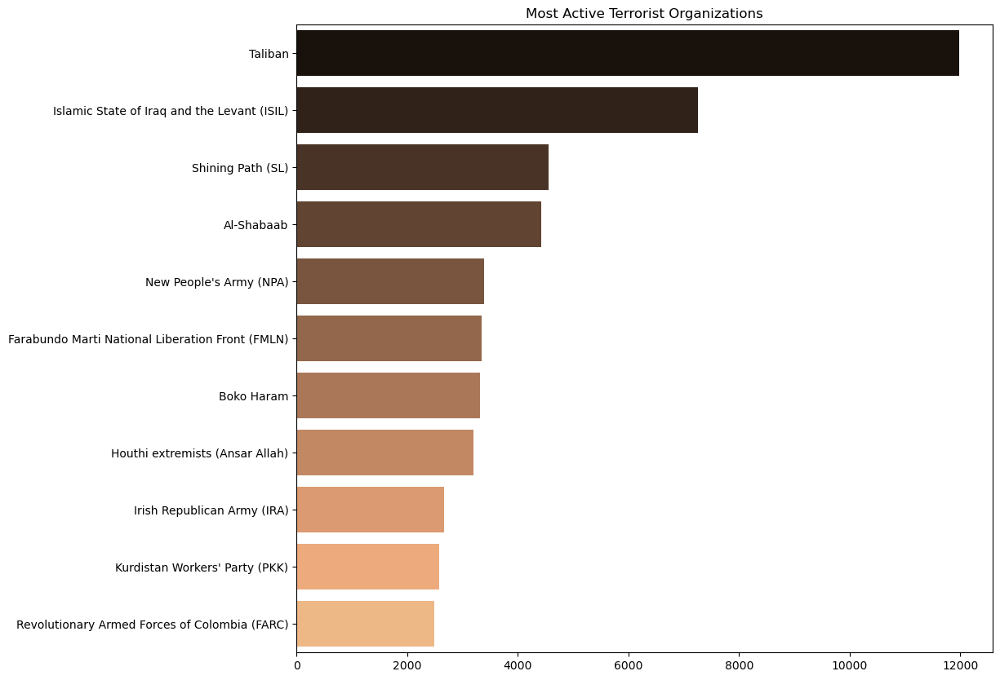

In [126]:
plt.subplots(figsize=(11,10))
sns.barplot(y=df['Group'].value_counts()[1:12].index,x=df['Group'].value_counts()[1:12].values,
           palette='copper')
plt.title('Most Active Terrorist Organizations')
plt.show()

### Now we will look closer at trend Before and after the War on Terror

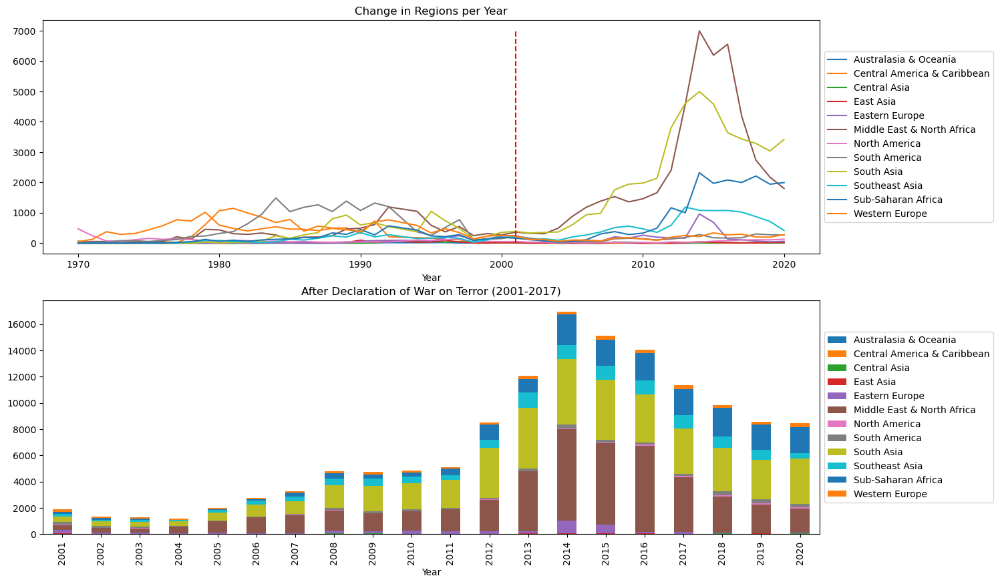

In [127]:
data_after = df[df['Year']>=2001]
fig,ax = plt.subplots(figsize=(15,10),nrows=2,ncols=1)
ax[0] = pd.crosstab(df.Year,df.Region).plot(ax=ax[0])
ax[0].set_title('Change in Regions per Year')
ax[0].legend(loc='center left',bbox_to_anchor = (1,0.5))
ax[0].vlines(x=2001,ymin=0,ymax=7000,colors='red',linestyles='--')
pd.crosstab(data_after.Year,data_after.Region).plot.bar(stacked=True,ax=ax[1])
ax[1].set_title('After Declaration of War on Terror (2001-2017)')
ax[1].legend(loc='center left',bbox_to_anchor = (1,0.5))
plt.show()

We can clearly notice that the regions before 2001 were not involved in the terrorism and there is not a rise in the terrorism but after 2001 some regions eventually raised in terms of terrorism activites.

### Insights derived from above Exploratory Data Analysis:

1.Taliban and ISIL has a most active organisation.

2.Maximum number of attacks are from Bombing/Explosions.

3.The Middle East and North Africa Regions has most targeted.

4.Iraq has the most attacks.

5.There are maximum number of attacks in Private citizens and Property.